##### **Analyse Sentinel-2 data**

See the [data getter](get_sentinel_data.ipynb) for further details on how the data was downloaded, which includes a degree of pre-processing.

In [1]:
from IPython.display import display, HTML

import numpy as np
import pandas as pd
from pathlib import Path
from tqdm.notebook import tqdm

import plotly.express as px

import multiprocessing

from sklearn.utils import shuffle

from collections import OrderedDict, defaultdict

from dython.nominal import associations

In [2]:
parent_dir = Path.home().joinpath('sentinel_data')
raw_dir = parent_dir.joinpath('raw_data')
shards_dir = parent_dir.joinpath('shards')

samples_dir = parent_dir.joinpath('samples')

sort_key = lambda x: int(x.stem.split('_')[-1])
features_filepaths = sorted(list(raw_dir.glob('features_*.npy')), key=sort_key)
labels_filepaths = sorted(list(raw_dir.glob('labels_*.csv')), key=sort_key)

These are the bands that have been downloaded. It follows the same order as the data structure.

In [3]:
tci_bands = dict(zip(['TCI_R', 'TCI_G', 'TCI_B'], ['red', 'green', 'blue']))
bgr_bands = dict(zip(['B2', 'B3', 'B4'], ['#00ffb5', '#c3ff00', '#ff0000']))
nir_bands = dict(zip(['B5', 'B6', 'B7', 'B8', 'B8A'],px.colors.cyclical.Twilight[:5]))
swir_bands = dict(zip(['B11', 'B12'], px.colors.qualitative.Plotly[:2]))
all_bands = bgr_bands | nir_bands | swir_bands | tci_bands

Evaluate the masked values (masked as zeros). The goal is to replace the zeros with their respective band average to avoid scaling issues as the band values can have different ranges.

The band average is only representative if there is a sufficient amount of non-zeros. 

In [4]:
def zcore_normalise_X(X, mean, std):
    return (X - mean)/std

def minmax_normalise_X(X, p1_min, p1_max, mean):
    X_scaled = np.where((X < p1_min) | (X > p1_max), mean, X)
    X_scaled = (X_scaled - p1_min)/(p1_max - p1_min)
    return X_scaled

In [5]:
def get_mean_std(features_filepaths):
    std_path = samples_dir.joinpath('std.npy')
    mean_path = samples_dir.joinpath('mean.npy')
    p1_min_path = samples_dir.joinpath('p1_min.npy')
    p1_max_path = samples_dir.joinpath('p1_max.npy')
    
    if std_path.is_file():
        std = np.load(std_path, allow_pickle=True).item()
        mean = np.load(mean_path, allow_pickle=True).item()
        p1_min = np.load(p1_min_path, allow_pickle=True).item()
        p1_max = np.load(p1_max_path, allow_pickle=True).item()
        return mean, std, p1_min, p1_max
    
    mean, std, p1_min, p1_max = OrderedDict(), OrderedDict(), OrderedDict(), OrderedDict()
    for i, band in enumerate(tqdm(all_bands)):
        band_data = []
        for filepath in tqdm(features_filepaths, leave=False):
            with open(filepath, 'rb') as f:
                raw_data = np.load(f)
                band_data.append(np.copy(raw_data[band]))

        band_data = np.vstack(band_data)
        mean[band] = band_data.mean()
        std[band] = band_data.std()
        p1_min[band] = np.percentile(band_data, 1)
        p1_max[band] = np.percentile(band_data, 99)
    
    np.save(mean_path, mean)
    np.save(std_path, std)
    np.save(p1_min_path, p1_min)
    np.save(p1_max_path, p1_max)
    
    return mean, std, p1_min, p1_max

n_chunks = 40
mean, std, p1_min, p1_max = get_mean_std(shuffle(features_filepaths, random_state=42)[:n_chunks])

In [6]:
def get_band_samples(samples_per, features_filepaths):
    band_samples_path = samples_dir.joinpath('feature_samples.npy')
    
    if band_samples_path.is_file():
        band_samples = np.load(band_samples_path, allow_pickle=True).item()
        return band_samples
    
    band_samples = {k: [] for k in all_bands}
    for f in tqdm(features_filepaths):
        raw_data = np.load(f)
        for band in all_bands:
            random_sample = raw_data[band].flatten()[:samples_per]
            band_samples[band].extend(random_sample)
    
    np.save(band_samples_path, band_samples)
    
    return band_samples
band_samples = get_band_samples(2000, shuffle(features_filepaths, random_state=42)[:20])

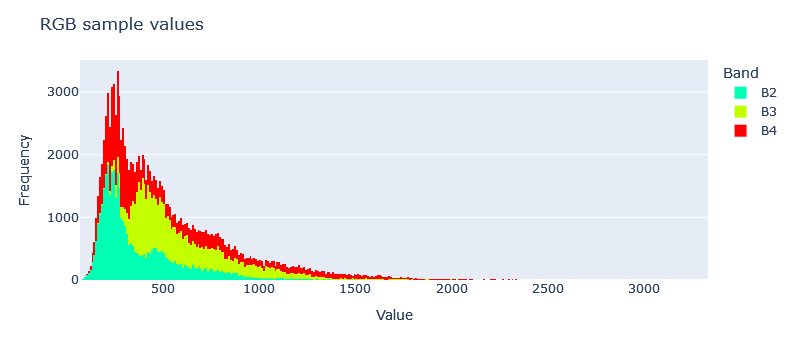

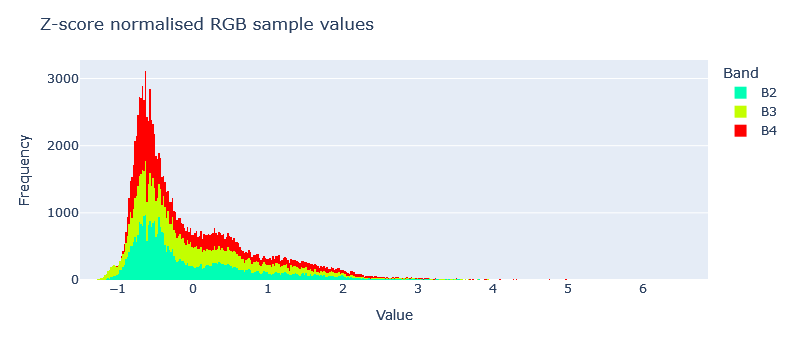

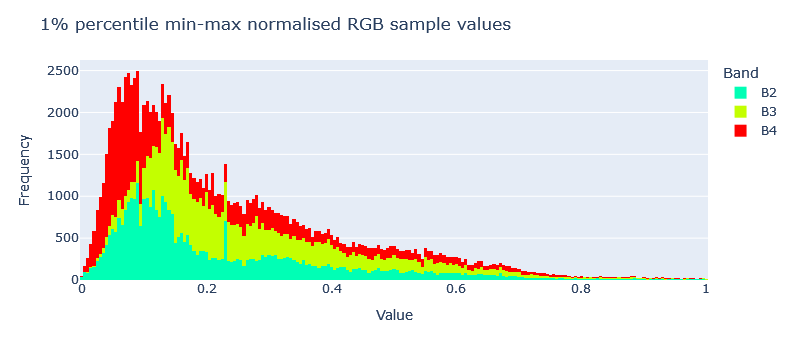

In [11]:
fig1 = px.histogram(
    {k: band_samples[k] for k in bgr_bands}, 
    color_discrete_map=bgr_bands).update_layout(
    xaxis_title='Value', yaxis_title="Frequency", title='RGB sample values',
    legend_title_text='Band', height=500
)
fig2 = px.histogram(
    {k: zcore_normalise_X(np.array(band_samples[k]), mean[k], std[k]) for k in bgr_bands}, 
    color_discrete_map=bgr_bands).update_layout(
    xaxis_title='Value', yaxis_title="Frequency", title='Z-score normalised RGB sample values',
    legend_title_text='Band', height=500
)

fig3 = px.histogram(
    {k: minmax_normalise_X(np.array(band_samples[k]), p1_min[k], p1_max[k], mean[k]) for k in bgr_bands}, 
    color_discrete_map=bgr_bands).update_layout(
    xaxis_title='Value', yaxis_title="Frequency", title='1% percentile min-max normalised RGB sample values',
    legend_title_text='Band', height=500
)
display(fig1, fig2, fig3)

In [23]:
fig1 = px.histogram({k: band_samples[k] for k in tci_bands}, 
             color_discrete_map=tci_bands).update_layout(
    xaxis_title='Value', yaxis_title="Frequency", title='True color sample values',
    legend_title_text='Band', height=500
)

fig2 = px.histogram({k: normalise_X(np.array(band_samples[k]), mean[k], std[k]) for k in tci_bands}, 
             color_discrete_map=tci_bands).update_layout(
    xaxis_title='Value', yaxis_title="Frequency", title='Normalised true color sample values',
    legend_title_text='Band', height=500
)
display(fig1, fig2)

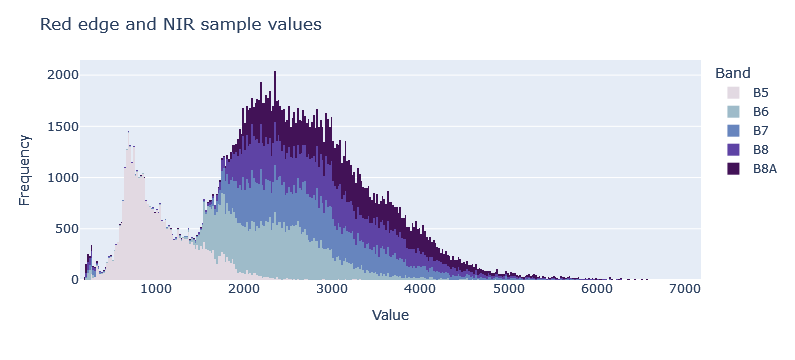

In [24]:
fig1 = px.histogram({k: band_samples[k] for k in nir_bands}, 
             color_discrete_map=nir_bands).update_layout(
    xaxis_title='Value', yaxis_title="Frequency", 
    title='Red edge and NIR sample values',
    legend_title_text='Band', height=500
)

fig2 = px.histogram({k: normalise_X(np.array(band_samples[k]), mean[k], std[k]) for k in nir_bands}, 
             color_discrete_map=nir_bands).update_layout(
    xaxis_title='Value', yaxis_title="Frequency", 
    title='Normalised edge and NIR sample values',
    legend_title_text='Band', height=500
)

display(fig1, fig2)

In [25]:
fig1 = px.histogram({k: band_samples[k] for k in swir_bands}, 
             color_discrete_map=swir_bands).update_layout(
    xaxis_title='Value', yaxis_title="Frequency", 
    title='Short-wave infrared sample values',
    legend_title_text='Band', height=500
)

fig2 = px.histogram({k: normalise_X(np.array(band_samples[k]), mean[k], std[k]) for k in swir_bands}, 
             color_discrete_map=swir_bands).update_layout(
    xaxis_title='Value', yaxis_title="Frequency", 
    title='Normalised short-wave infrared sample values',
    legend_title_text='Band', height=500
)

display(fig1, fig2)

The bands display positively skewed distributions. To mitigate this issue, the values are normalised using the 1st and 99th quartiles instead of the min and max values. To reduce skewedness, values outside the quartiles are replaced with medians.

In [6]:
normal_type = 'minmax'
def create_selected_shards(labels_filepaths, normal_type, min_occurrence=5000):
    all_labels = []
    for f in labels_filepaths:
        all_labels.append(pd.read_csv(f))
            
    all_labels = pd.concat(all_labels).reset_index(drop=True)
    selected_df = all_labels.T[all_labels.T.sum(axis=1) >= min_occurrence].T
    selected_df = selected_df[selected_df.sum(axis=1) > 0]
    
    print(f'Dropped {all_labels.shape[1] - selected_df.shape[1]} columns, '
          f'{all_labels.shape[0] - selected_df.shape[0]} rows')

    return selected_df.index.tolist()
min_occurrence = 5000 # change to 0 for entire dataset
selected_shards = create_selected_shards(labels_filepaths, normal_type, min_occurrence)

Dropped 212 columns, 12772 rows


In [7]:
len(selected_shards) / min_occurrence

47.5594

Use min_occurence to guide the choice of $batch_size$. That is, $samples / min\_occurrence$ gives the minimum $batch\_size$ where at least one sample from the minority class is expected, on average, to appear in a batch. For $samples=250,000$ and $min\_occurrence = 5,000$, $batch\_size_{min}=50$.

Breakup the data into individual samples.

**Note: as an awareness check, you must create directory shards first. This will contain the same data size. Original data is not affected.** 

In [9]:
def create_shards(i, labels_filepath, features_filepath, shards_dir, normal_type, selected_shards):
    labels = pd.read_csv(labels_filepath).to_numpy()
    n_shards = labels.shape[0]
    # total_shards = 0
    # for n in range(n_shards):
    #     shard_id = i*1000 + n
    #     if shard_id in selected_shards:
    #         s = shards_dir.joinpath(f'{normal_type}_features').joinpath(f'feature_{i*1000 + n}.npy')
    #         if s.is_file() and (s.stat().st_size == 1040128):
    #             total_shards += 1
    # if total_shards == n_shards:
    #     return
        
    # raw_features = np.load(features_filepath)
    
    # normalised_features = raw_features.view((float, len(raw_features.dtype.names)))
    # for band, k in enumerate(mean.keys()):
    #     if normal_type == 'minmax':
    #         normalised_features[..., band] = minmax_normalise_X(
    #             normalised_features[..., band], p1_min[k], p1_max[k], mean[k]
    #         )
    #     if normal_type == 'zscore':
    #         normalised_features[..., band] = zscore_normalise_X(
    #             normalised_features[..., band], mean[k], std[k]
    #         )
    
    for ii in range(n_shards):
        shard_id = i*1000 + ii
        if shard_id in selected_shards:
            # np.save(
            #     shards_dir.joinpath(f'{normal_type}_features').joinpath(f'feature_{shard_id}.npy'), 
            #     normalised_features[ii, ...]
            # )
            np.save(
                shards_dir.joinpath(f'{normal_type}_labels').joinpath(f'label_{shard_id}.npy'), 
                labels[ii, ...]
            )

parts = [int(f.stem.split('_')[-1]) for f in features_filepaths]
selected_shards = shuffle(selected_shards, random_state=42)[:50000] # limited due to storage
normal_type = 'minmax'

map_inputs = [(i, l, f, shards_dir, normal_type, selected_shards) for i, l, f in zip(parts, labels_filepaths, features_filepaths)]

n_processes = multiprocessing.cpu_count() - 1
with multiprocessing.Pool(processes=n_processes) as p:
    p.starmap(create_shards, tqdm(map_inputs), chunksize=1)

  0%|          | 0/251 [00:00<?, ?it/s]

Get a few samples and display a few images as an animation.

In [15]:
def get_sample_images(sample_ids):
    plots = pd.read_csv('plots.csv')
    std = list(np.load(samples_dir.joinpath('std.npy'), allow_pickle=True).item().values())
    mean = list(np.load(samples_dir.joinpath('mean.npy'), allow_pickle=True).item().values())
    
    features = []
    labels = []
    for sample_id in sample_ids:
        features.append(np.load(shards_dir.joinpath(f'feature_{sample_id}.npy')))
        labels.append(plots.iloc[sample_id]['SPECIES NAME'])

    rgb = np.stack(features)
    rgb = rgb * np.array(std) + np.array(mean)
    rgb = rgb[..., -3:]
    return rgb, np.vstack(labels)

n_samples = 50
ids = [int(s.stem.split('_')[-1]) for s in shards_dir.glob(f'feature_*.npy')]
sample_ids = shuffle(ids, random_state=42)[:n_samples] 
rgb, labels = get_sample_images(sample_ids)

In [ ]:
def visualise_grid(rgb, labels):
    fig = px.imshow(rgb, 
                    animation_frame=0, height=500, width=500
                   )
    for frame_name, step in zip(labels, fig.layout.sliders[0].steps):
        step.label = ','.join(frame_name)
    
    fig.update_xaxes(visible=False)
    fig.update_yaxes(visible=False)
    fig.update_layout(margin={'t':0,'l':0,'b':0,'r':0})
    return fig

# visualise_grid(rgb, labels)

Perform a correlation analysis. In order to do this, either flatten the images into a 2d array or take the means of the 36 pixels.

In [ ]:
def calculate_corrs(filepaths, all_bands, target_df, method_means=False):
    corrs = []
    for filepath in tqdm(filepaths):
        with open(filepath, 'rb') as f:
            data = np.load(filepath)
            if method_means:
                df = pd.DataFrame(np.mean(data, axis=(1, 2)), columns=all_bands)
                df['target'] = target_df.astype('category').values
            else:
                df = pd.DataFrame(data.reshape(-1, len(all_bands)), columns=all_bands)
                df['target'] = target_column.astype('category').repeat(10000).values
            
            corrs.append(associations(df, compute_only=True)['corr'].round(1))
    return corrs

For further details: http://shakedzy.xyz/dython/

In [ ]:
# corrs = calculate_corrs(filepaths, all_bands, df, method_means=False)
# fig = px.imshow(
#     np.array(corrs),
#     animation_frame=0,
#     labels=dict(color="Corr coef"),
#     x=corrs[0].index,
#     y=corrs[0].columns,
#     title='Seasonal correlation heatmap',
#     text_auto=True, aspect='auto', zmin=0, height=500
# )
# for season, step in zip([s.stem for s in seasonal_paths], fig.layout.sliders[0].steps):
#     step.label = season

# fig